In [1]:
using QuantumToolbox
using SparseArrays
using PlotlyJS
using Arpack
using IterTools

In [2]:
# # can't be autoreloaded
# include("basic_codes.jl")
# using .basic_codes

In [2]:
function get_liouvillian(N::Int, Delta::Real, tg::Real, k1::Real, kphi::Real)
    """
    Constructs the Liouvillian superoperator from a Hamiltonian and a set of collapse operators.
    
    Parameters:
    H (Operator): The Hamiltonian of the system.
    c_ops (Vector{Operator}): A vector of collapse operators.
    
    Returns:
    Liouvillian: The Liouvillian superoperator.
    """
    # define operators
    a = destroy(N)
    ad = create(N)

    # adjust Parameters
    U = tg/sqrt(1+tg^2)
    k2 = 1/sqrt(1+tg^2)
   
    # Construct the Hamiltonian
    H = Delta*ad*a + G/2*(ad^2+a^2) - U/2*(a^2*ad^2)

    # collapse operators
    c_ops = [sqrt(k2)*a^2, sqrt(k1)*a, sqrt(kphi)*ad*a]
    
    # Construct the Liouvillian
    L = liouvillian(H, c_ops)

    return L, a, ad
end;

# function to plot the wigner function
function plot_wigner(rho,xx,yy)
    layout = Layout(
        xaxis_title="Re(β)",
        yaxis_title="Im(β)",
        title="Wigner function",
        width=500,
        height=500
    )
    
    w = wigner(rho, xx, yy);
    vbound = maximum(abs.(w))

    custom_colorscale = [
        [0, "blue"],   # Negative values to blue
        [0.5, "white"],  # Zero values to white
        [1, "red"],     # Positive values to red
    ]

    heatmap_trace = heatmap(
        z=w,
        x=xx,
        y=yy,
        colorscale=custom_colorscale,
        showscale=true,
        zmin = -vbound,
        zmax = vbound
    )

    plot(heatmap_trace, layout)
end;

# fix the size of the vector which has support only in one block 
function completevec(vec, nblock, P, block_indices, block_sizes; unvectorize=true, retQobj=true, tosparse=true)
    # make a (possibly sparse) vector the correct size of the full system
    v = tosparse ? sparse(zeros(ComplexF64,(sum(block_sizes),1))) : zeros(ComplexF64,(sum(block_sizes),1))

    # put the vector in the correct block (the rest is zero)
    v[block_indices[nblock]:block_indices[nblock]+block_sizes[nblock]-1] = vec

    # apply the conjugate permutation to revert into original basis
    v = P'*v

    # depending on vectorization/qobj, return the correct vector
    if retQobj
        v = unvectorize ? QuantumObject(reshape(v, (N,N))) : QuantumObject(v)
    else
        v = unvectorize ? reshape(v, (N,N)) : v
    end
    return v
end

# get the lowest lying states and values from the different symmetry sectors
function get_lowlying(N::Int, G::Real, Delta::Real, tg::Real, k1::Real, kphi::Real, nev::Int, sigma::Real, nvecs=2)
    # Get the Liouvillian
    L, a, ad  = get_liouvillian(N, Delta, tg, k1, kphi)
    # Get the block diagonal form of the Liouvillian with bdf function 
    P, Lbd, block_sizes = bdf(L)
    block_list, block_indices = get_bdf_blocks(Lbd,block_sizes)

    # set up the lists for the eigenvalues and eigenvectors
    ρl = []
    Λl = Vector{ComplexF64}[]

    # adjust the number of eigenvalues to be calculated
    nev = maximum([nev, nvecs])

    # loop over all blocks (either 2 or 4 depending on k1)
    for nblock in 1:length(block_list)
        evals, evecs = eigs(block_list[nblock],  nev=nev, sigma=sigma) # diagonalize sparse matrix
        args         = sortperm(abs.(real.(evals))) # permuation of sorted eigenvalues
        evals, evecs = evals[args], evecs[:,args]

        Λ = evals[1:nvecs]
        ρ = collect(eachcol(evecs[:,1:nvecs])) # take only first nvecs eigenvectors and change to array

        ρ = map(x->completevec(x, nblock, P, block_indices, block_sizes; unvectorize=true), ρ) # make the vectors the correct size and unvectorize them
        ρ = map(x-> abs(tr(x))>0.1 ? x/tr(x)  : x/x.data[x.data.!=0][1], ρ) # normalize the vectors (density matrices)
        ρ = map(x-> abs(tr(x))>0.1 ? (x+x')/2 : x+x' , ρ)

        # append the values to the return lists
        push!(ρl,ρ)
        push!(Λl,Λ)
    end
    return Λl, ρl
end;

# spectral decomposition function
function spectral_decomposition(ρ)
    # warning if trace is not 0
    matrix_trace = tr(ρ)
    if abs(matrix_trace)>1e-10
        print("Warning: trace of input matrix $matrix_trace is not zero", )
    end
    # spectral decomposition
    ri,ψi = eigen(ρ)
    
    # separate positive and negative eigenvalues (guaranteed to be real if ρ is hermitian)
    cp = real(ri).>0
    cm = real(ri).<0

    # arrays of positive and negative eigenvalues and eigenvectors
    ep = ri[cp]
    em = ri[cm]
    vp = ψi[cp]
    vm = ψi[cm]
    
    # initialize density matrices
    ρp = ep[1]*ket2dm(QuantumObject(vp[1]))
    ρm = em[1]*ket2dm(QuantumObject(vm[1]))
    
    # loop over positive space projectors
    for i in 2:length(ep)
        p = ep[i]
        v = vp[i]
        ρp += p*ket2dm(QuantumObject(v))
    end
    
    # loop over negative space projectors
    for i in 2:length(em)
        p = em[i]
        v = vm[i]
        ρm += -p*ket2dm(QuantumObject(v))
    end
    
    # normalize
    ρm = ρm/tr(ρm)
    ρp = ρp/tr(ρp)

    return ρp, ρm
end;

function spectral_decomposition_bis(rho)
    # simple spectral decomposition
    es, sts = eigen(rho)

    iplus = findall(x->real(x)>0, es)
    iminus = findall(x->real(x)<0, es)

    rho_p = sum(es[i] * sts[:][i] * sts[:][i]' for i in iplus)
    rho_m = sum(-es[i] * sts[:][i] * sts[:][i]' for i in iminus)

    rho_p /= tr(rho_p)
    rho_m /= tr(rho_m)

    return rho_p, rho_m
end;

spectral_decomposition (generic function with 1 method)

In [27]:
N = 40
Delta = 0.
G = 5.
tg = 1e2
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

L, a, ad = get_liouvillian(N, Delta, tg, k1, kphi);

In [28]:
# get the eigenvalues of the Liouvillian
spectrum, states = eigenstates(L);

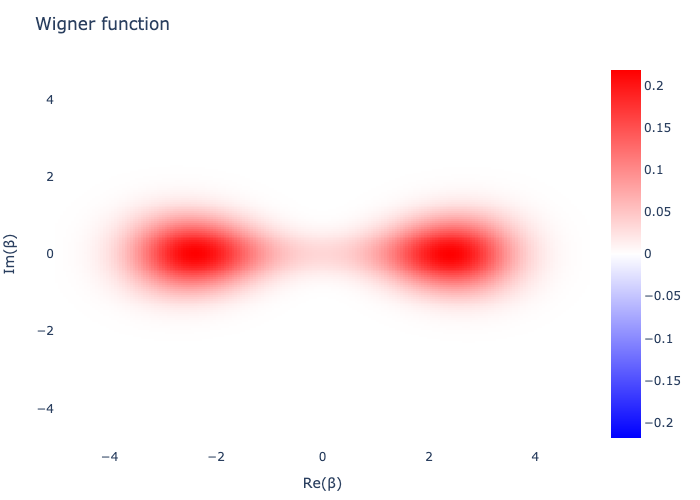

In [29]:
xvec = range(-5, 5, length=200)
plot_wigner(vec2mat(states[end]), xvec, xvec)

# Encoding states

## $\Delta = 0$

In [124]:
# set parameters
N = 90
Δ0 = 0.
G = 5.
tg = 1e5 # not sure about this one
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7;

In [125]:
rates, states = get_lowlying(N, G, Δ0, tg, k1, kphi, nev, sigma);
ρ0p = states[1][1]
ρ1p = states[1][2]
ρ0m = states[2][1]
ρ1m = states[2][2];

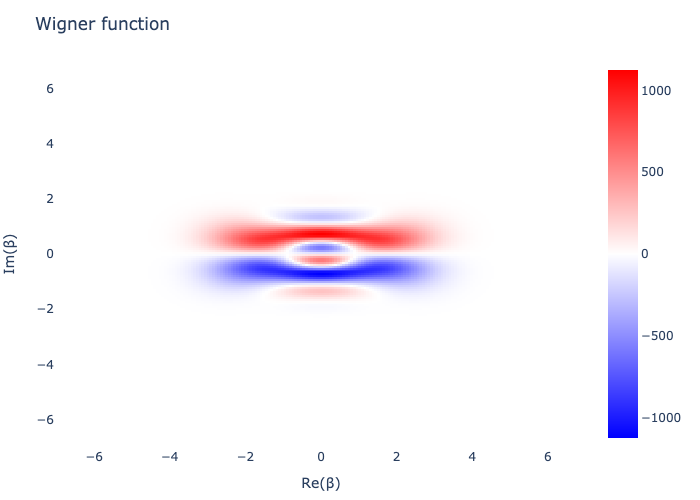

In [126]:
xvec = range(-7, 7, length=200)
plot_wigner(ρ0m, xvec, xvec)

In [127]:
ρ0mp, ρ0mm = spectral_decomposition(ρ0m);

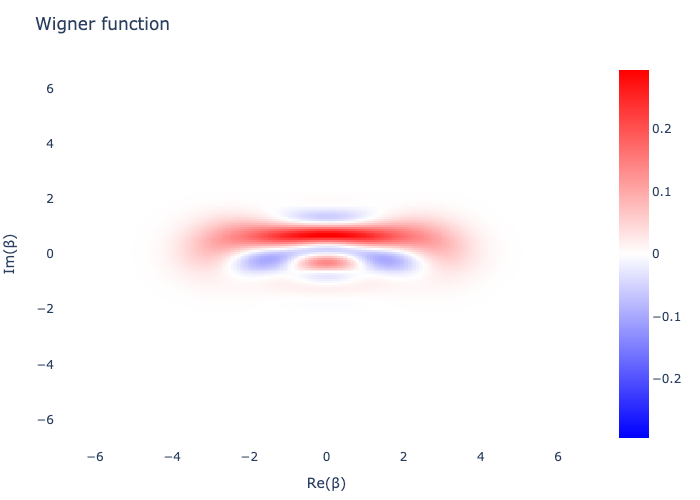

In [128]:
plot_wigner(ρ0mp, xvec, xvec)

## $\Delta > 0$

In [129]:
# set parameters
Δb = 5;

In [130]:
rates, states = get_lowlying(N, G, Δb, tg, k1, kphi, nev, sigma);
ρ0p_b = states[1][1]
ρ1p_b = states[1][2]
ρ0m_b = states[2][1]
ρ1m_b = states[2][2];

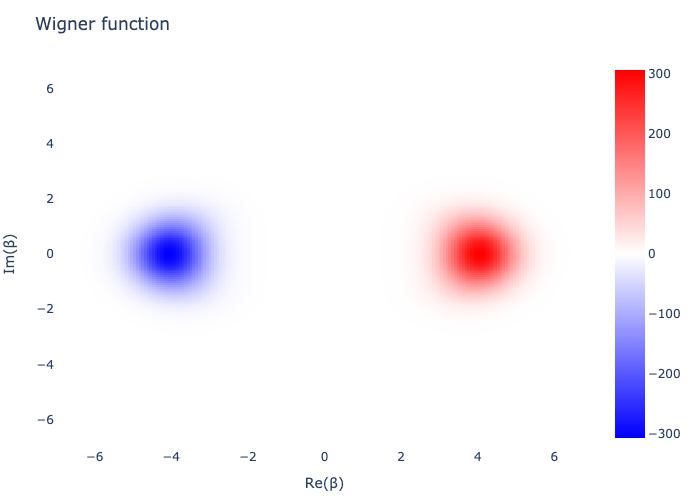

In [131]:
plot_wigner(ρ0m_b, xvec, xvec)

In [132]:
ρ0mp_b, ρ0mm_b = spectral_decomposition_bis(ρ0m_b);

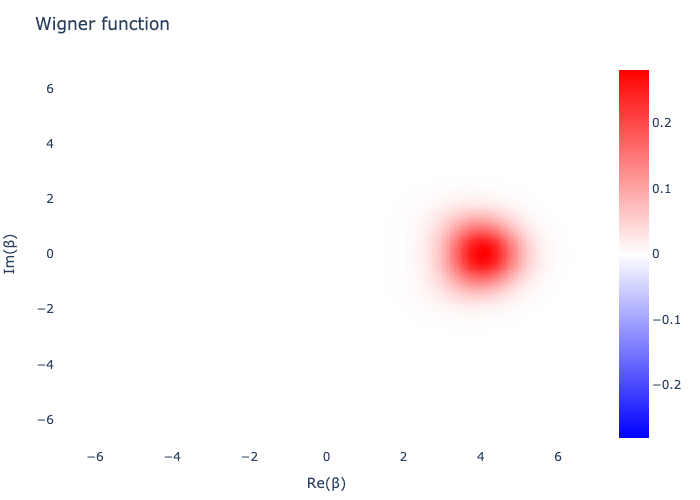

In [133]:
plot_wigner(ρ0mp_b, xvec, xvec)

## $\Delta > \Delta_c$

In [134]:
# set parameters
Δc = 25;

In [135]:
rates, states = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma);
ρ0p_c = states[1][1]
ρ1p_c = states[1][2]
ρ0m_c = states[2][1]
ρ1m_c = states[2][2];

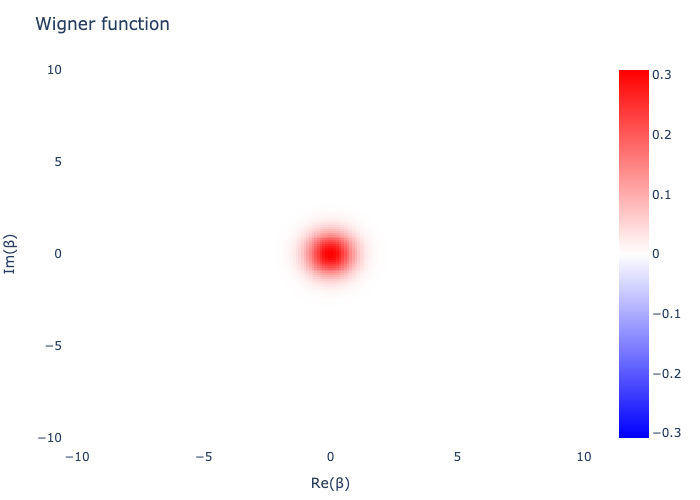

In [136]:
plot_wigner(ρ0p_c, xvec.*1.5, xvec.*1.5) # steady state is now a squeezed vacuum state

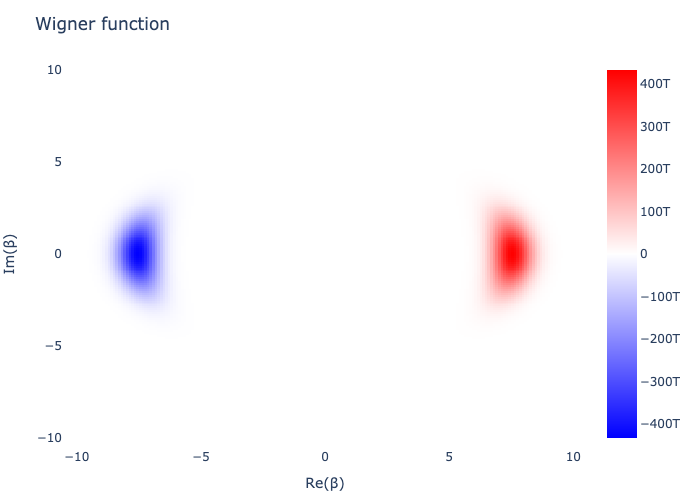

In [137]:
plot_wigner(ρ0m_c, xvec.*1.5, xvec.*1.5)

In [138]:
# new center of bloch sphere is in the first excited state
ρ1pp_c, ρ1pm_c = spectral_decomposition_bis(ρ1p_c);

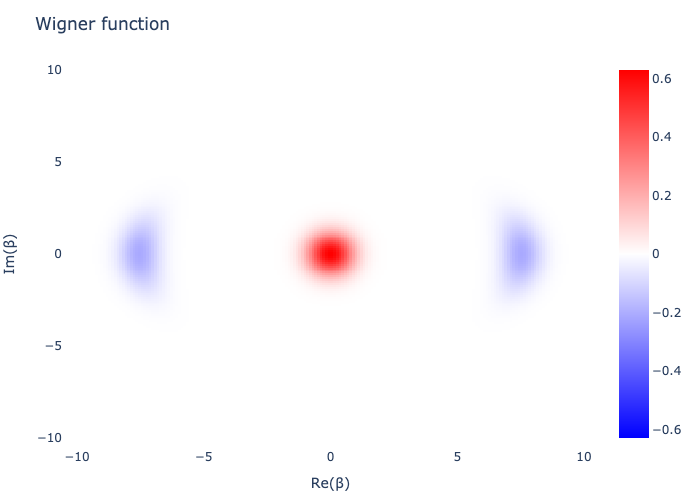

In [142]:
plot_wigner(ρ1p_c, xvec.*1.5, xvec.*1.5) # made up of steady state and bloch sphere center

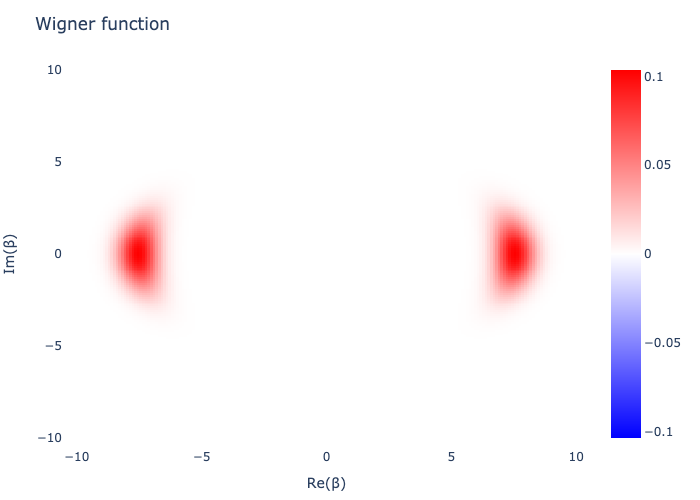

In [140]:
plot_wigner(ρ1pm_c, xvec.*1.5, xvec.*1.5)

# Spectral weights $\langle \sigma | \rho \rangle$

In [21]:
N = 40
Δc = 25.
G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

# make the Liouvillian
L, a, ad = get_liouvillian(N, Δc, tg, k1, kphi);

In [22]:
# get left eigenvectors of Liouvillian

# block diagonalize the Liouvillian
P, Lbd, block_sizes = bdf(L)
block_list, block_indices = get_bdf_blocks(Lbd,block_sizes);

# make lists to store the eigenvectors and eigenvalues
vrl, λrl, vll = [], [], []

# loop over blocks
for i in 1:length(block_list)
    # get the eigenvectors and eigenvalues
    λr, vr = eigen(Matrix(block_list[i]), sortby = x -> -real(x))
    # convert them into left eigenvectors
    vl = inv(vr)'

    # completevec on each column
    f = vv -> completevec(vv, 1, P, block_indices, block_sizes, unvectorize=false, retQobj=false, tosparse=false)
    push!(vll, mapreduce(f, hcat, eachcol(vl)))
    push!(λrl, λr)
end
# put them all into one matrix
vll = hcat(vll...)
λrl = hcat(λrl...) # still has two dimensions instead of just list


args = sortperm(abs.(real(vec(λrl))))
vll = vll[:,args]
λrl = λrl[args];


In [23]:
# array of left eigenvectors
λr, vl = λrl[1:end], vll[:,1:end];

In [24]:
# get the right eigenoperator of interest
rates, ρs = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma)
ρ0m_c = ρs[2][1]

ρ0mp_c, ρ0mm_c = spectral_decomposition(ρ0m_c);
v = vec(ρ0mp_c.data)
O = abs.(map(s->s'*v/(norm(s)*norm(v)), eachcol(vl)));

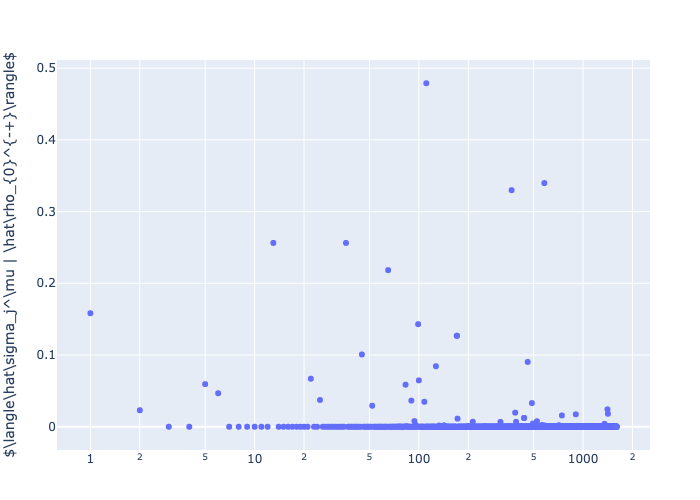

In [25]:
scatter_plot = scatter(x=collect(1:length(O)),y=O, mode="markers")

layout = Layout(
    yaxis_title=raw"$\langle\hat\sigma_j^\mu | \hat\rho_{0}^{-+}\rangle$",
    xaxis_type="log"
)

plot(scatter_plot, layout)

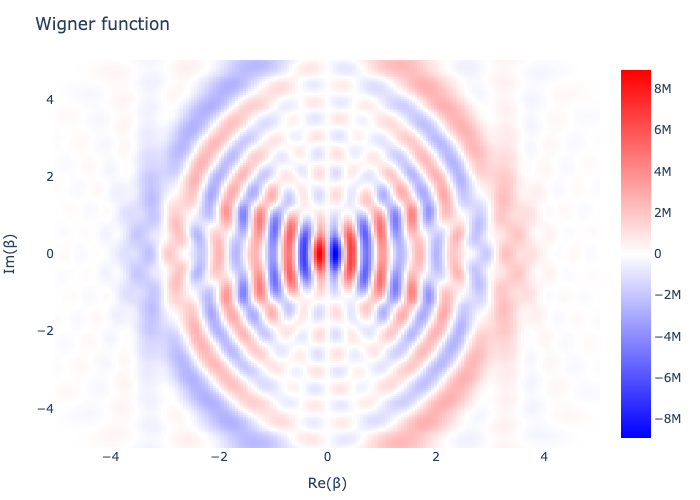

In [26]:
plot_wigner(ρ0m_c, xvec, xvec)

# Order parameter 

How does $\langle a^{\dagger}a\rangle$ change as a function of $\Delta$?

In [122]:
# expectation values
N = 90 # only go to high N if using sparse matrices
res = 200
Deltas = range(0,30,length=res)
expval, expval_p, expval_m = [], [], []

for i in 1:res
    # set Delta
    Δ = Deltas[i]
    # get liouvillian
    L, a, ad = get_liouvillian(N, Δ, tg, k1, kphi)
    # get the states of interest
    rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
    # get the steady state
    ρss = ρs[1][1]
    # get the rho_1_+ density matrices
    ρ1p = ρs[1][2]
    # decompose it
    ρ1p_p, ρ1p_m = spectral_decomposition_bis(ρ1p)
    # compute expectation values of the number operator
    push!(expval, real(expect(ad*a,ρss)))
    push!(expval_m, real(expect(ad*a,ρ1p_m)))
    push!(expval_p, real(expect(ad*a,ρ1p_p)))
end

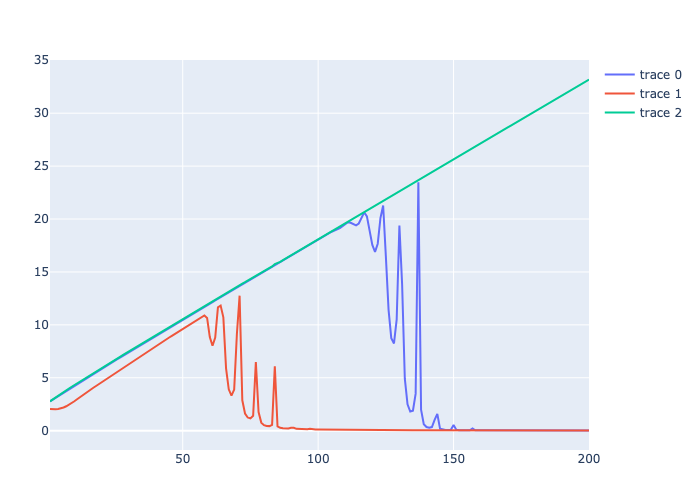

In [123]:
op_plot = scatter(x=collect(1:res),y=expval)
op_plot_p = scatter(x=collect(1:res),y=expval_p)
op_plot_m = scatter(x=collect(1:res),y=expval_m)

plot([op_plot,op_plot_p, op_plot_m])

# Debug station

### 